### Lets see our data after tracking objects with particle filter:

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cv2
from scipy.spatial.distance import euclidean
from fastdtw import fastdtw
from sklearn.cluster import DBSCAN


In [136]:
df = pd.read_csv('output/PETS09-S2L1.txt', header=None)
df = df.iloc[:, 0:4]
df.columns = ['frame', 'track_id', 'x', 'y']

In [137]:
df.head()

,frame,track_id,x,y
0,1,4,515.94,194.20
1,1,3,270.66,256.09
2,1,2,671.73,274.64
3,2,4,515.16,193.47
4,2,3,272.94,263.88


In [138]:
df['track_id'] = df['track_id'].astype(int)
display_im = np.flip(cv2.imread('mot_benchmark/train/PETS09-S2L1/img1/000218.jpg'), axis=0)

### plotting all the tracks:

we can see we have a lot of short tracks that we can get rid of later.

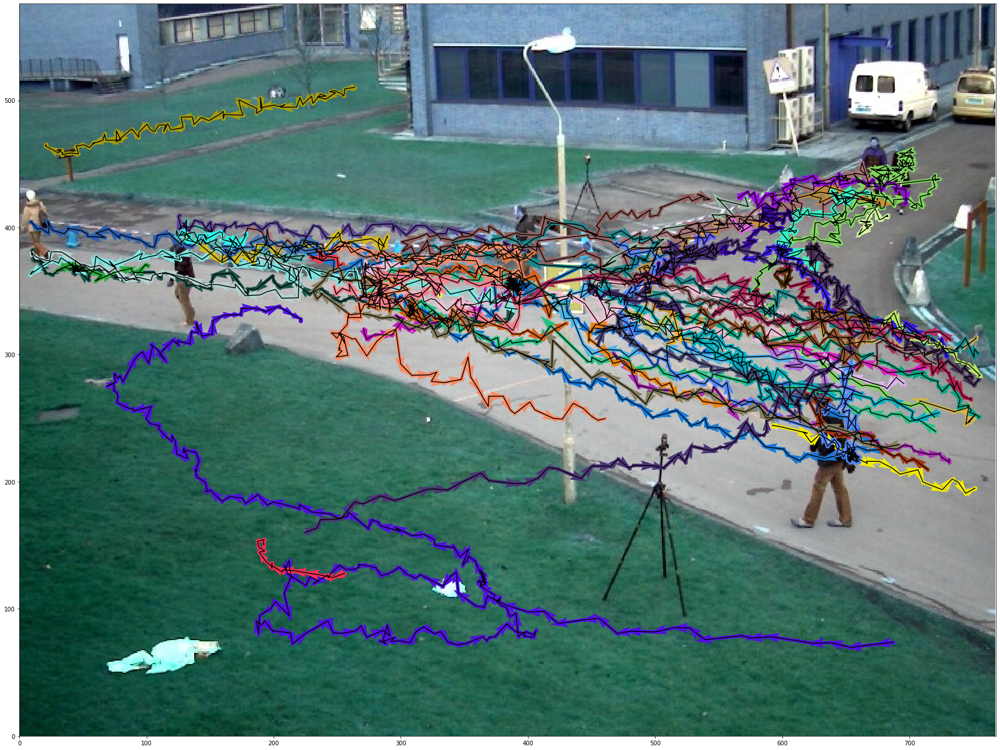

In [148]:
# creating dictionary of all the tracks ids as keys and their tracks positions list as values: 

tracks_ids = df.track_id.unique()
tracks_dict = {tid: df[df.track_id==tid][['x','y']].to_numpy() for tid in tracks_ids}
colors_dict = {tid: np.random.rand(1,3) for tid in tracks_ids}

# this function will display the tracks given on tracks_dict with quivers and the tracks colors:
def plot_tracks_with_quivers(tracks_dict, tracks_colors_dict, title = ""):
    res = np.array([display_im.shape[1], display_im.shape[0]])
    fig, ax = plt.subplots(figsize=res/25)
    ax.set_title(title)
    ax.set_xlim([0, res[0]])
    ax.set_ylim([0, res[1]])
    plt.imshow(display_im)
    for tid, track in tracks_dict.items():
        c = tracks_colors_dict.get(tid, None)
        if c is None:
            continue
        d = np.r_[track[1:,:] - track[:-1,:], [[0,0]]]
        plt.plot(track[:, 0], res[1]-track[:, 1], '-k')
        ax.quiver(track[:, 0], res[1]-track[:, 1], d[:, 0], -d[:, 1],
                  color=np.repeat(c, len(track), axis=0),
                  scale=600,
                  width=0.0035)
        plt.scatter(track[:, 0], res[1]-track[:, 1], c=c)
        
plot_tracks_with_quivers(tracks_dict, colors_dict)

### Our model:

first I got rid of the short tracks, then I calculated the distance matrix between all the tracks using fastdtw as our metric

after that I used DBSCAN with metric="precomputed" and fitted according to the distance matrix with the best epsilon and min_samples I found.

In [140]:


def fastdtw_metric(t1, t2):
    distance, path = fastdtw(t1, t2, dist=euclidean)
    return distance/len(path)

# taking only the long tracks from our dict:
tracks = [track for track in tracks_dict.values() if len(track) > 15]
#calculating distance matrix:
dist_matrix = np.zeros([len(tracks), len(tracks)])
for i, track_i in enumerate(tracks):
    for j, track_j in enumerate(tracks):
        dist_matrix[i,j] = fastdtw_metric(track_i, track_j)


Lets try to use DBSCAN with eps=50, min_samples=2:

In [141]:
# running DBSCAN on it:
cluster = DBSCAN(eps=50, min_samples=2, metric="precomputed")
clusters_for_tracks = cluster.fit_predict(dist_matrix)
clusters_for_tracks

array([-1,  0,  1, -1,  2,  2,  1,  1,  1,  0, -1, -1,  2,  2,  0,  2,  3,
        3, -1,  4,  1,  5,  2,  2,  0,  2,  1, -1,  1,  2,  2,  3,  2, -1,
       -1,  1, -1,  3,  2, -1, -1,  2, -1,  5,  5,  4,  5,  0,  1,  3,  1,
        2,  0,  2,  1,  5])

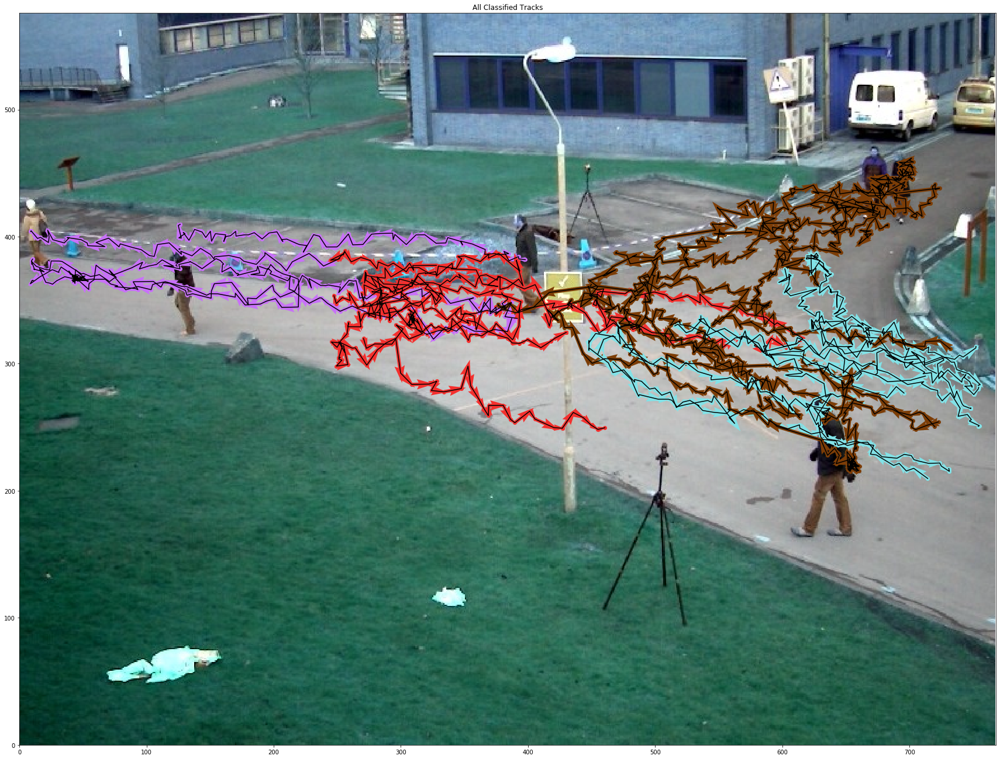

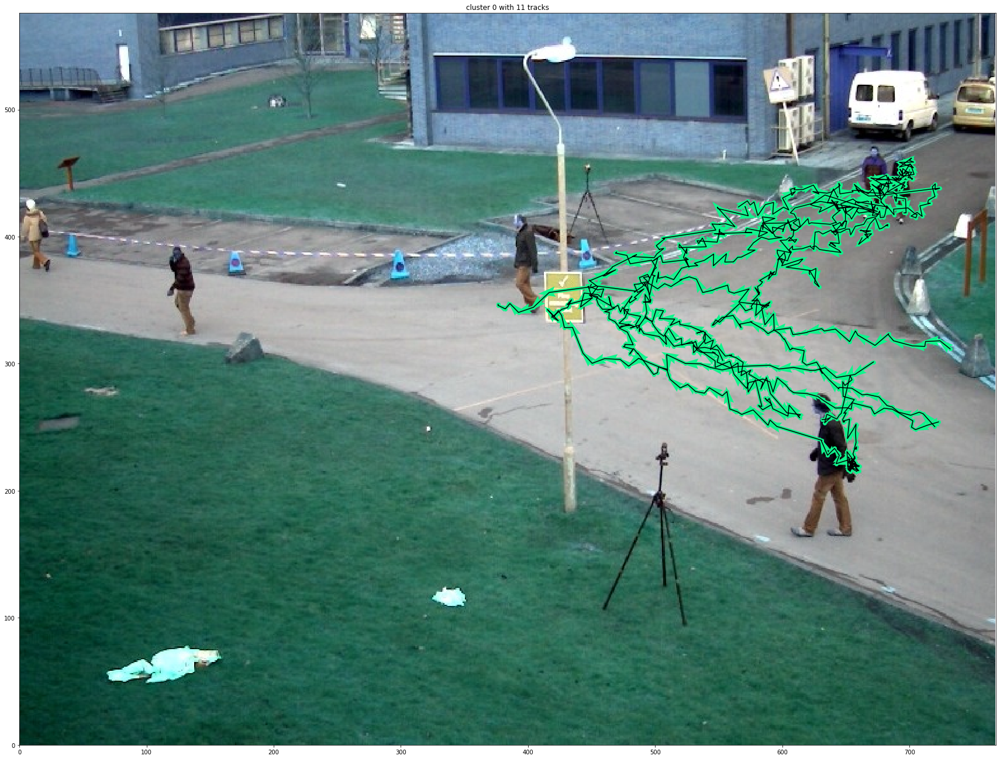

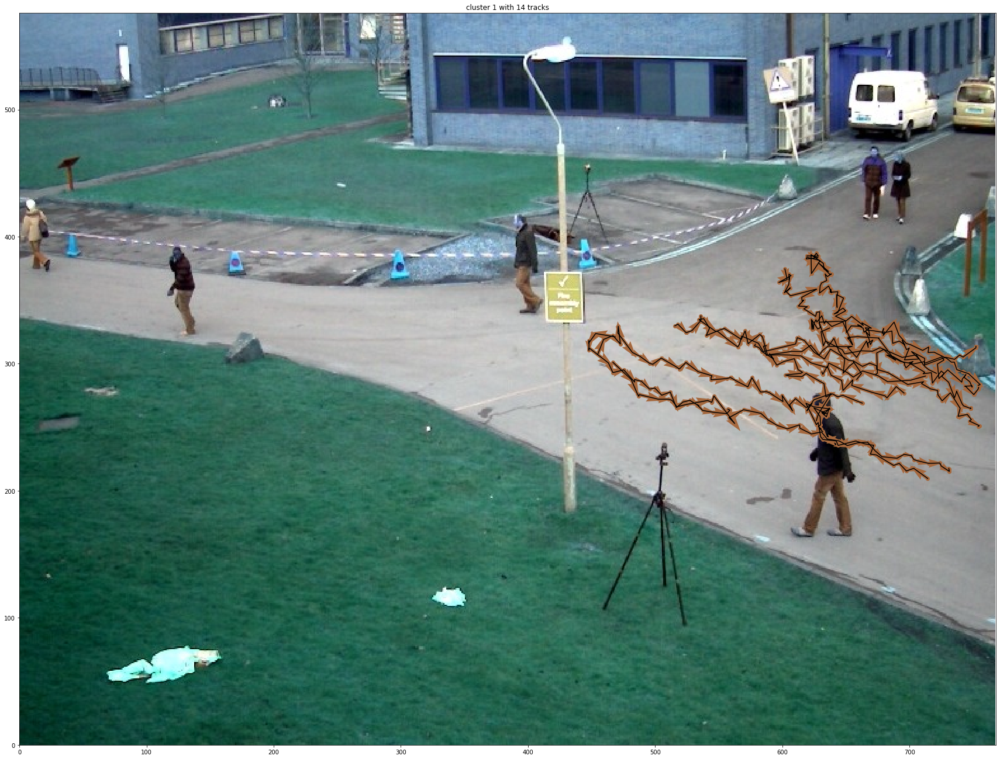

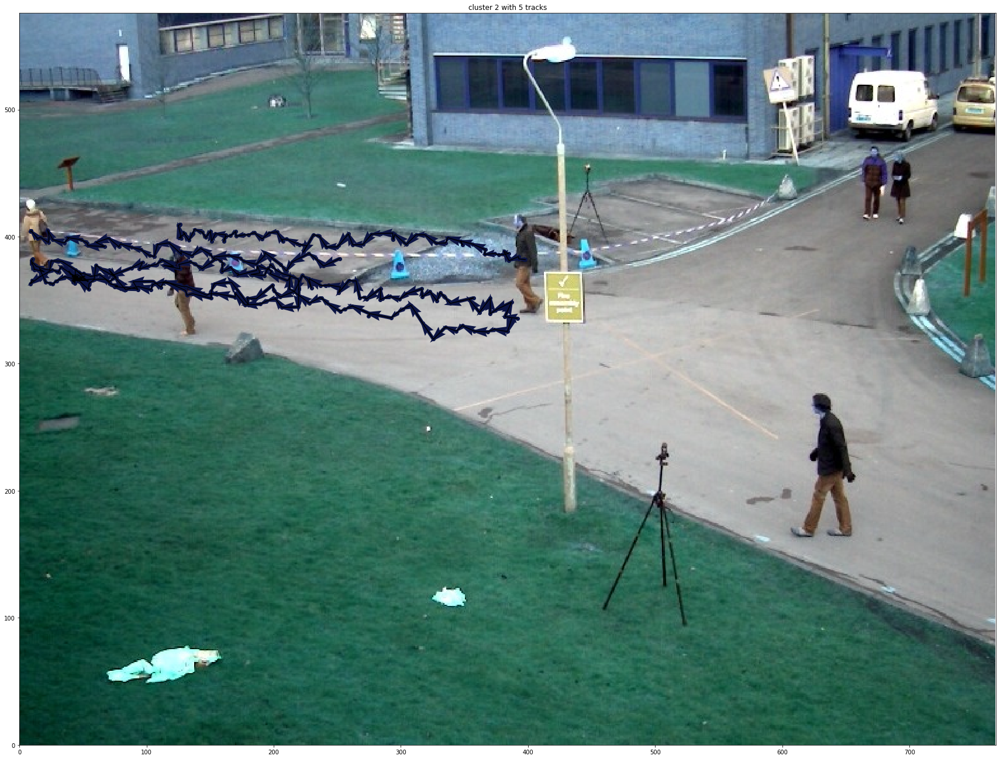

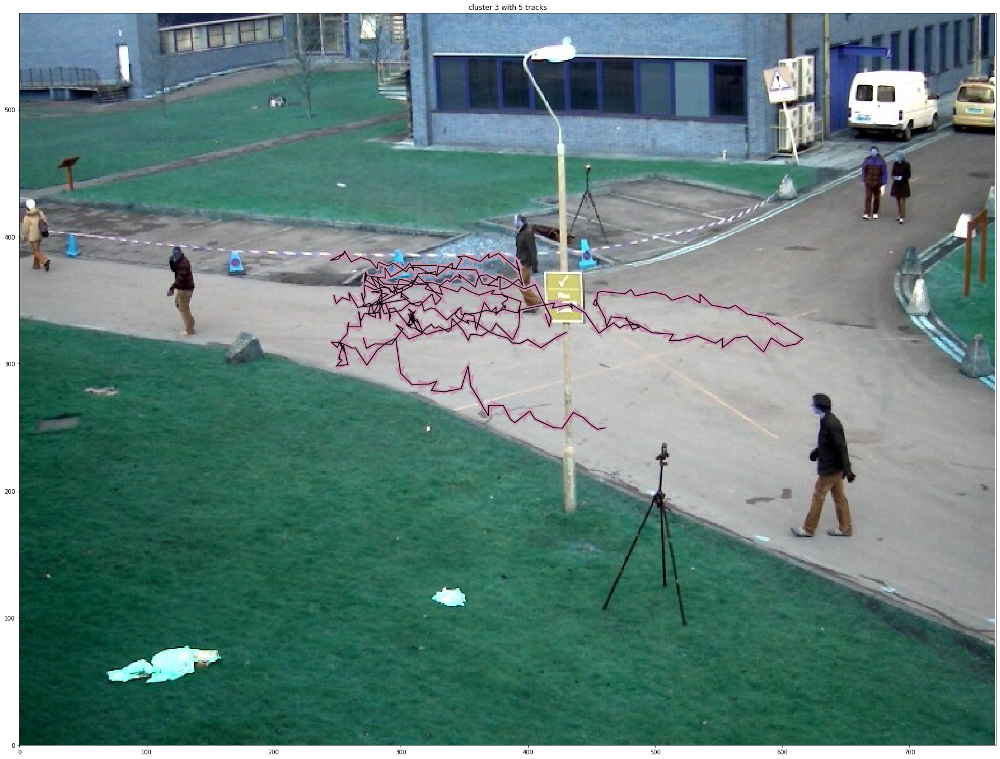

In [149]:
clustered_tracks_dict = {i: track for i, track in enumerate(tracks)}

all_cids = np.unique(clusters_for_tracks)
clusters_colors = {cid: np.random.rand(1,3) for cid in all_cids}
# give each track the same color if it comes from the same cluster:
color_dict = {i: clusters_colors[clusters_for_tracks[i]] for i in range(len(tracks)) if clusters_for_tracks[i]>=0}
plot_tracks_with_quivers(clustered_tracks_dict, color_dict, "All Classified Tracks")

def plot_every_cluster_alone_no_noise(tracks, clusters_for_tracks):
    
    all_cids = np.unique(clusters_for_tracks)
    clusters_colors = {cid: np.random.rand(1,3) for cid in all_cids}
    color_dict = {i: clusters_colors[clusters_for_tracks[i]] for i in range(len(tracks))}
    for cluster in all_cids:
        if cluster >= 0:
            cluster_tracks = {i: track for i, track in enumerate(tracks) if clusters_for_tracks[i] == cluster}
            tracks_colors = {i: color_dict[i] for i, track in enumerate(tracks) if clusters_for_tracks[i] == cluster}
            title = "cluster {} with {} tracks".format(cluster, len(cluster_tracks))
            plot_tracks_with_quivers(cluster_tracks, tracks_colors, title)
            plt.show()

plot_every_cluster_alone_no_noise(tracks, clusters_for_tracks)
# Watch the titles of the plots:


Now lets try with larger eps, because we got some small tracks that seemed like the same and didnt clustered together:

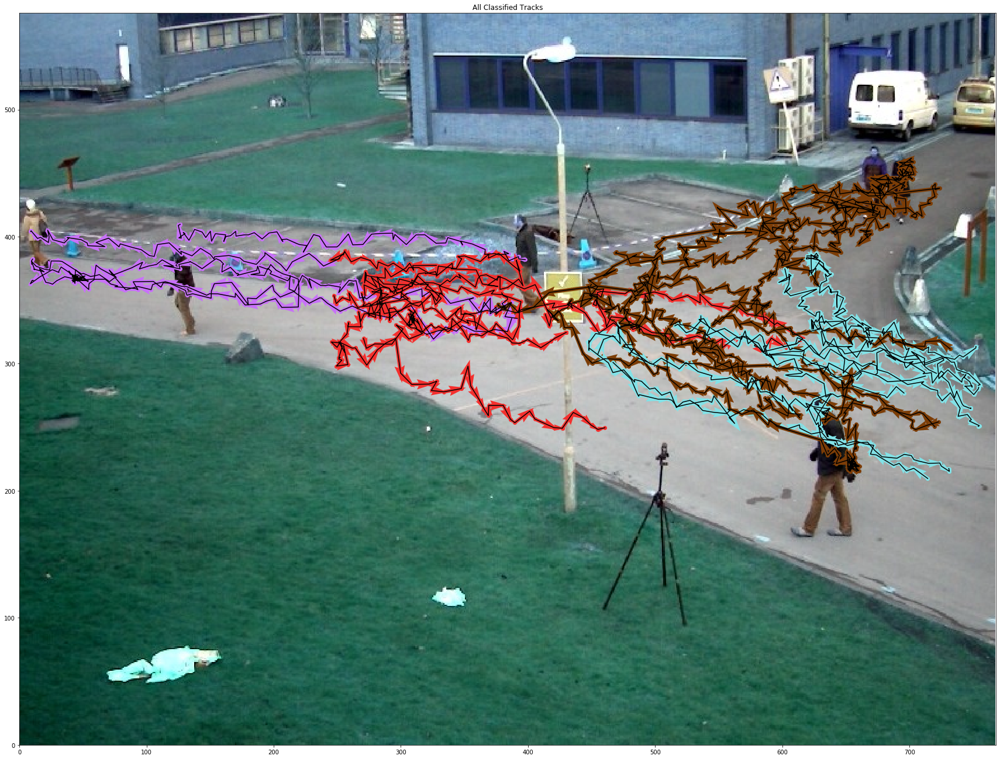

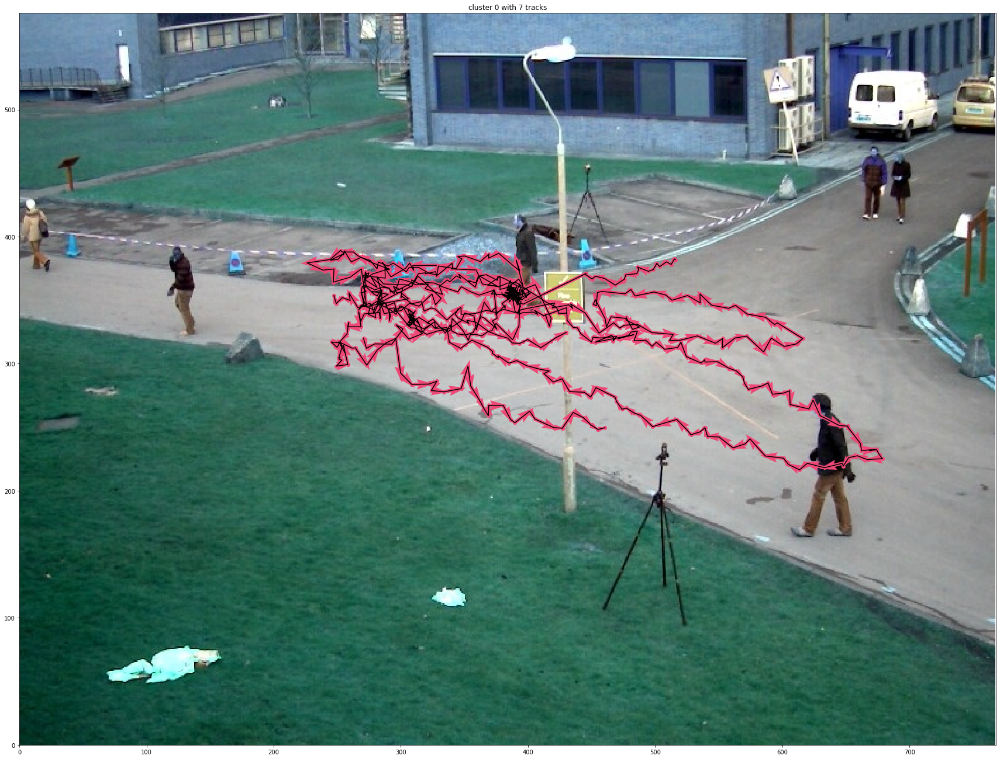

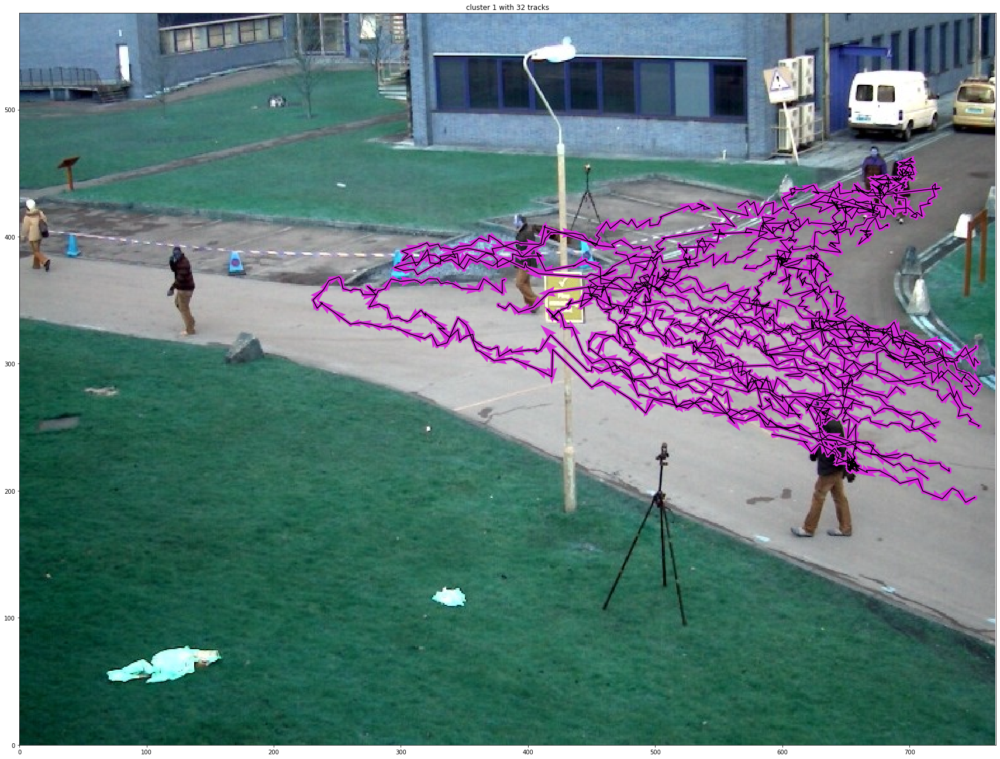

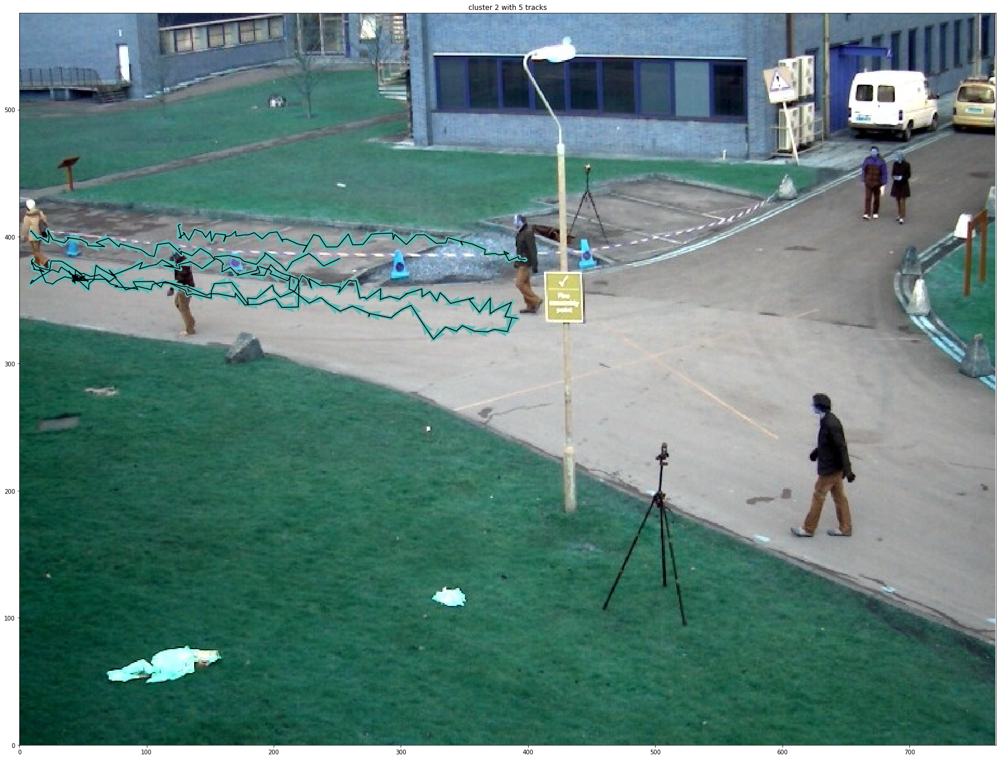

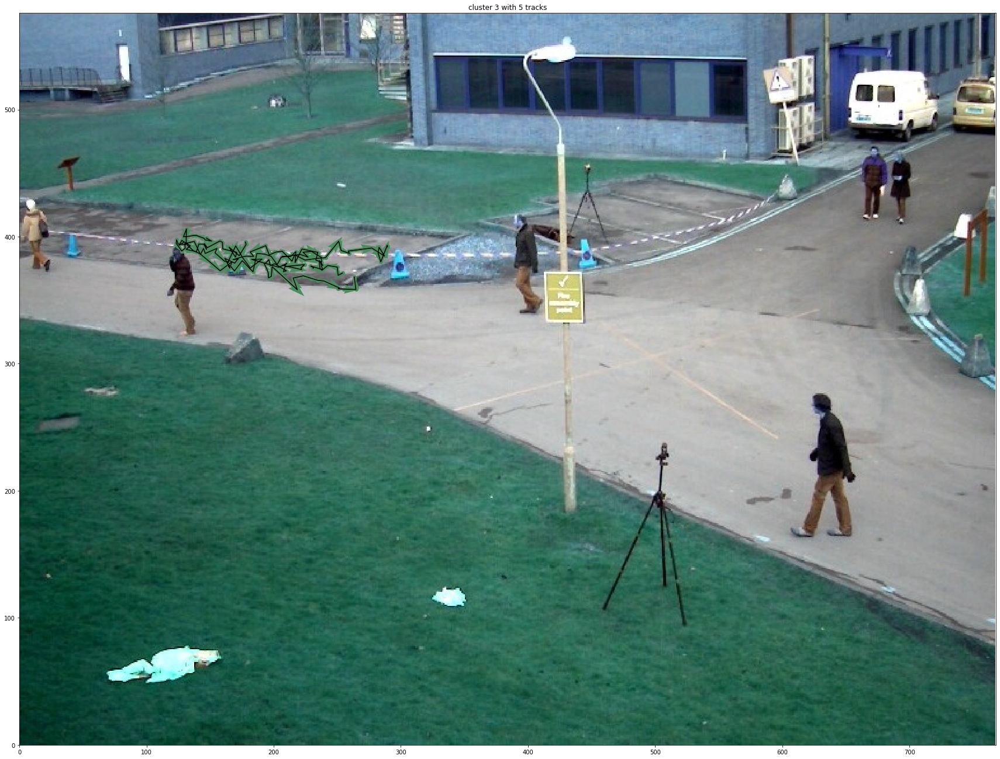

In [150]:
cluster = DBSCAN(eps=55, min_samples=2, metric="precomputed")
clusters_for_tracks = cluster.fit_predict(dist_matrix)
plot_tracks_with_quivers(clustered_tracks_dict, color_dict, "All Classified Tracks")
plot_every_cluster_alone_no_noise(tracks, clusters_for_tracks)

The first try with eps=50 got a better result which gave different classes to tracks on different directions, and had an over all better classification by looking at it.

just because we can. lets try some more different hyperparameters for the DBSCAN:

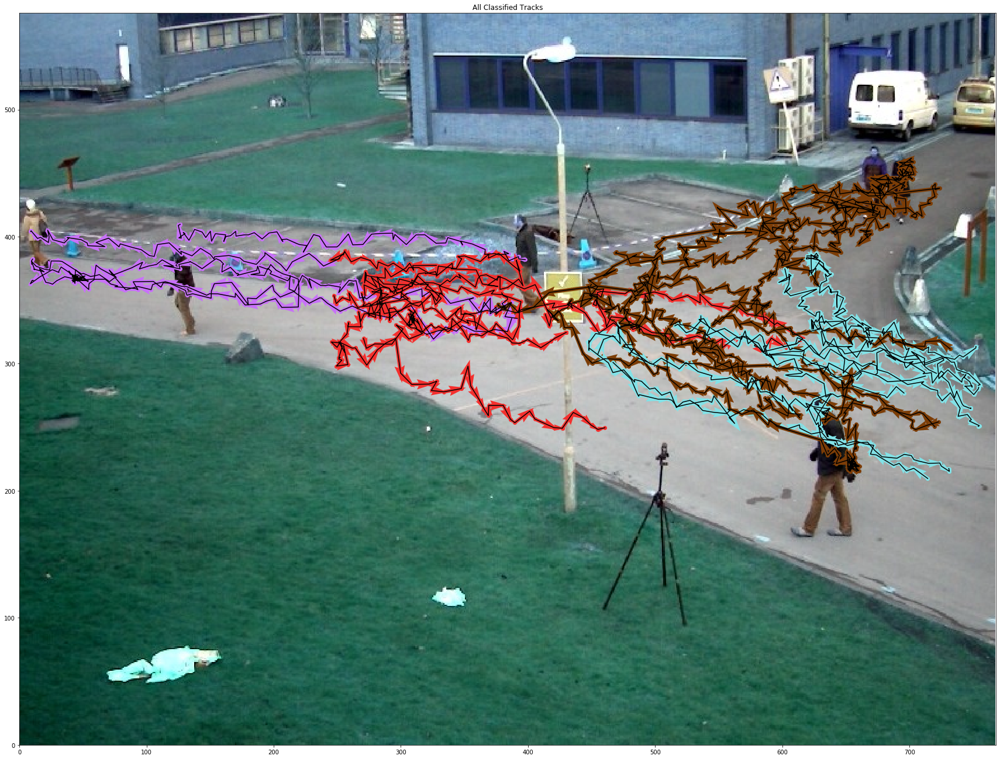

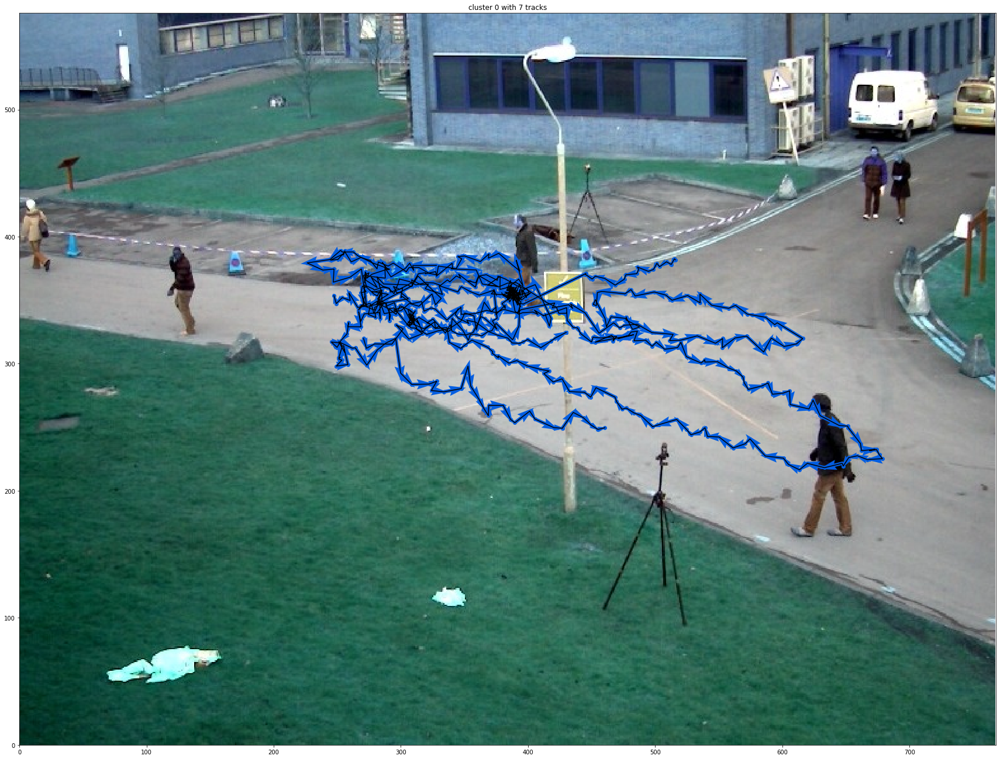

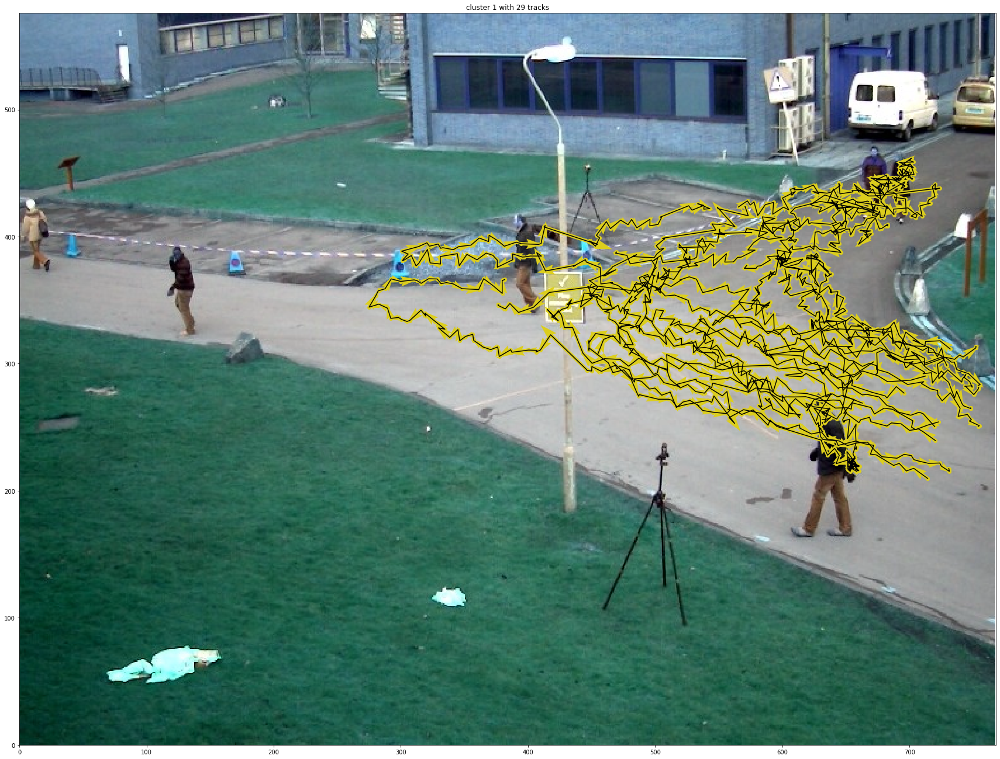

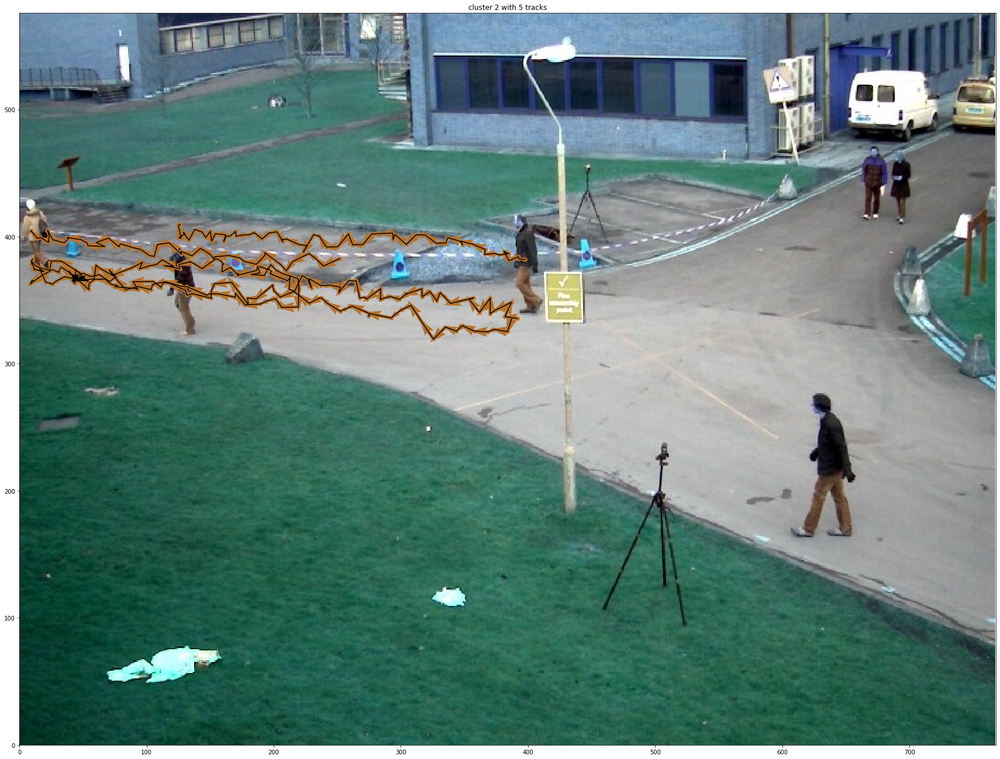

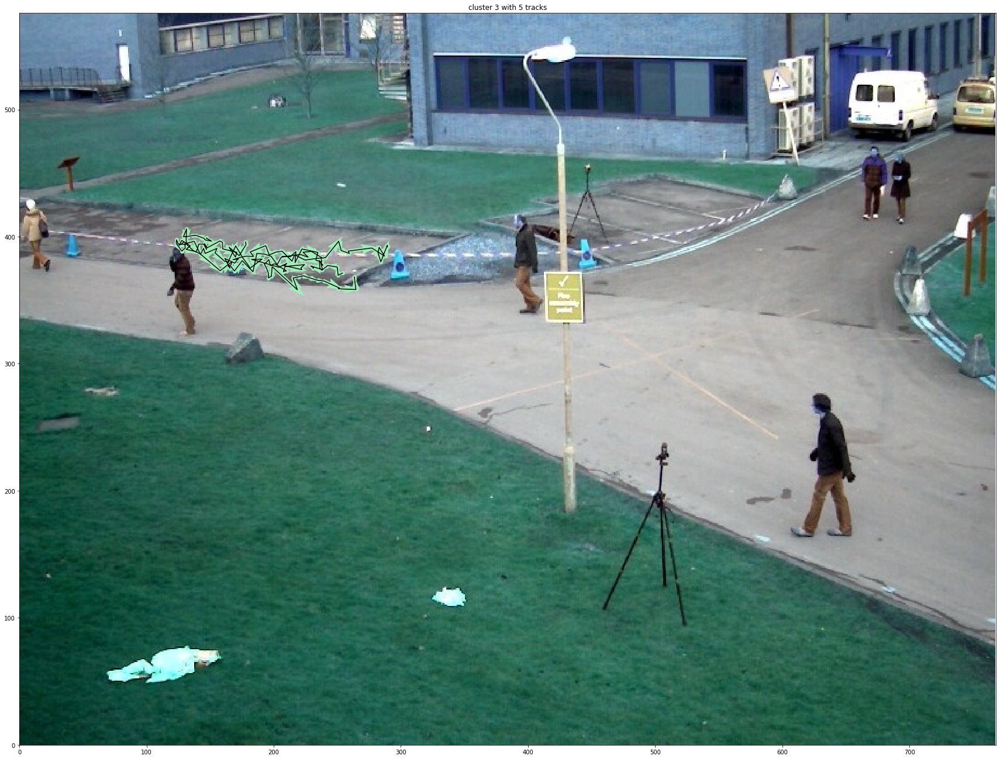

In [151]:
cluster = DBSCAN(eps=55, min_samples=4, metric="precomputed")
clusters_for_tracks = cluster.fit_predict(dist_matrix)
plot_tracks_with_quivers(clustered_tracks_dict, color_dict, "All Classified Tracks")
plot_every_cluster_alone_no_noise(tracks, clusters_for_tracks)

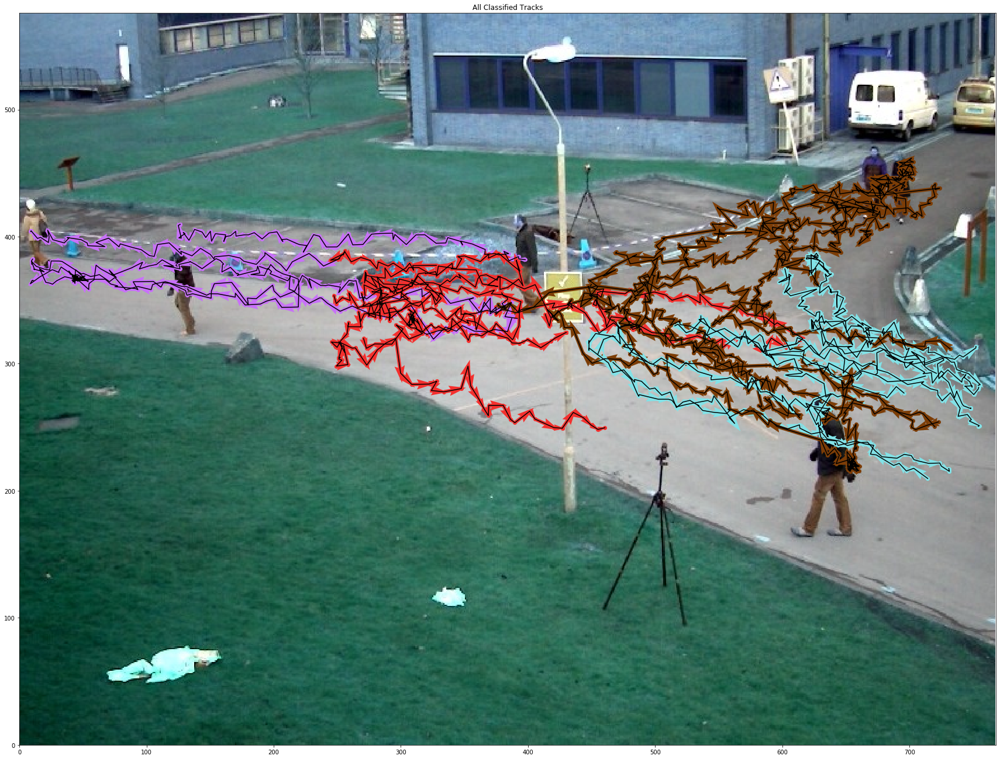

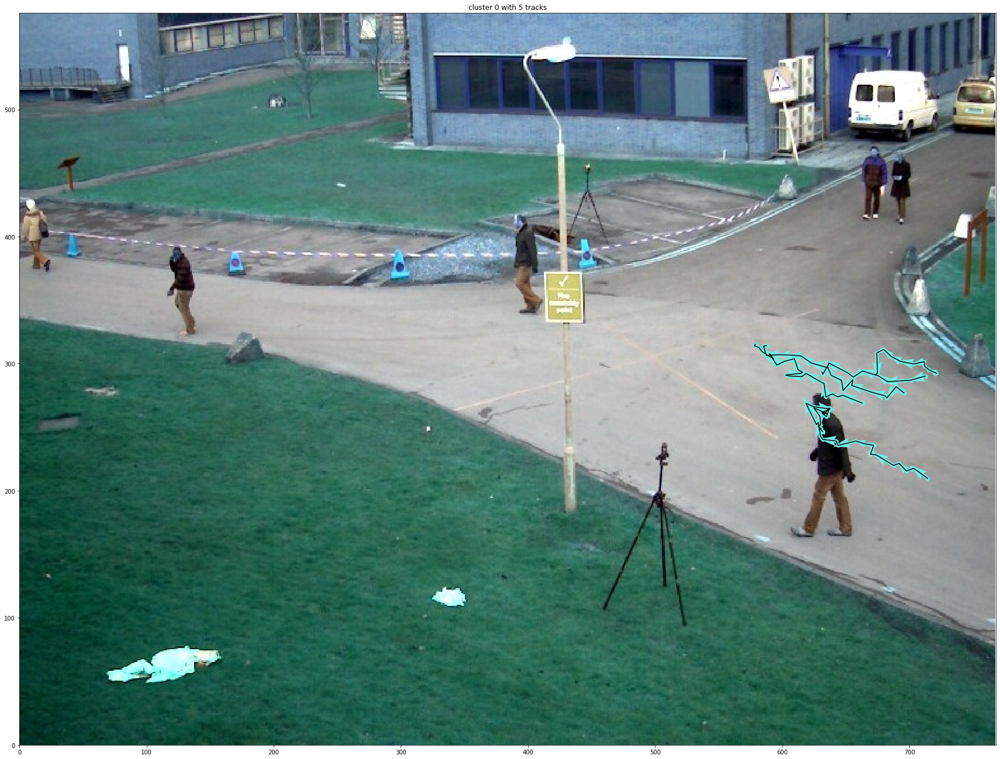

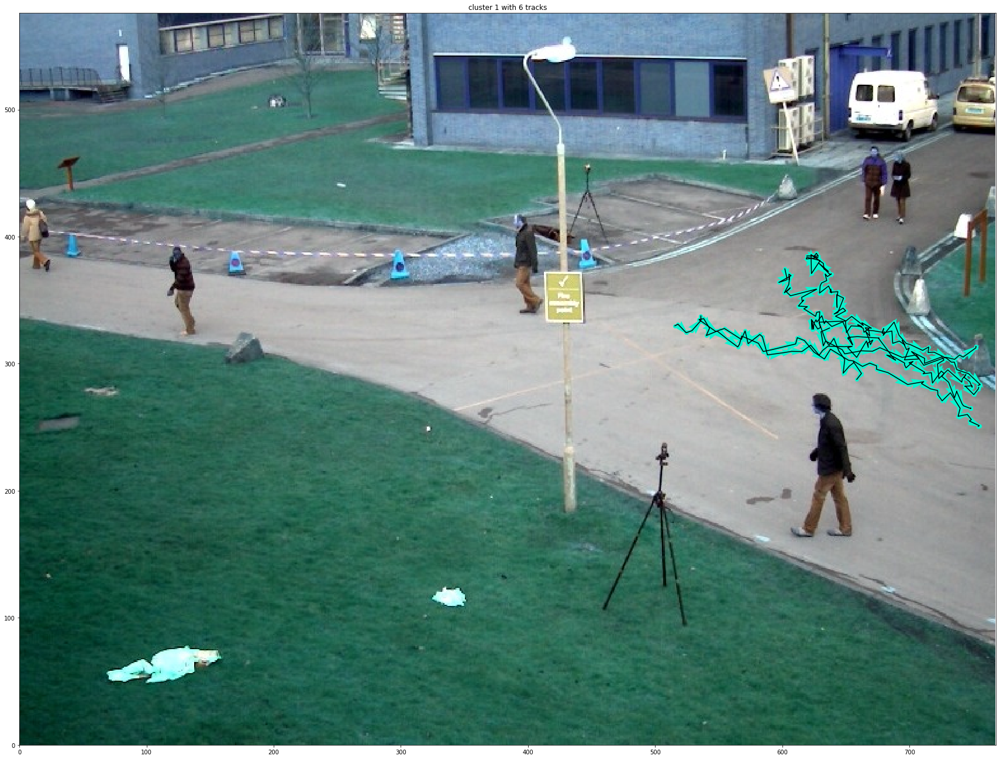

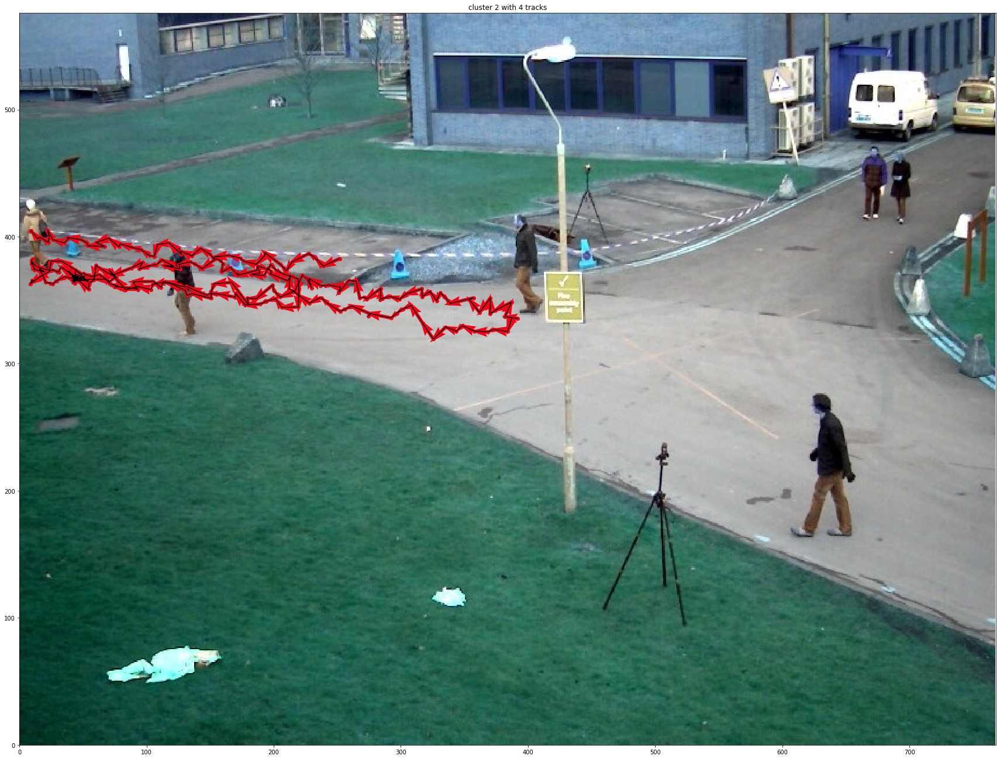

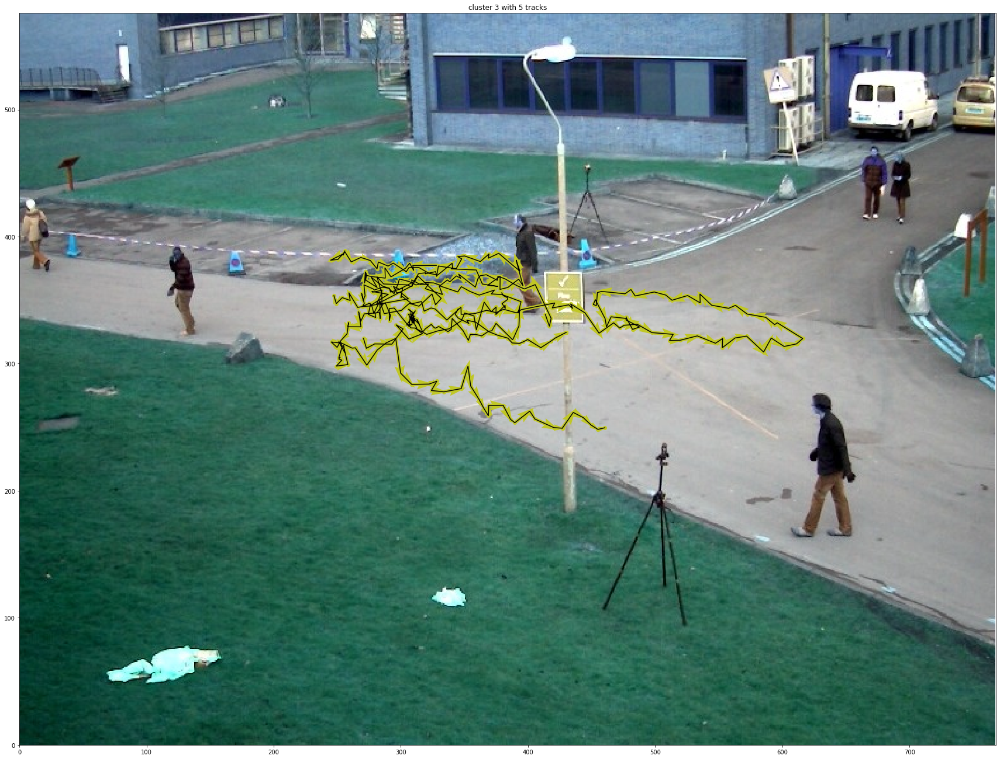

In [152]:
cluster = DBSCAN(eps=45, min_samples=4, metric="precomputed")
clusters_for_tracks = cluster.fit_predict(dist_matrix)
plot_tracks_with_quivers(clustered_tracks_dict, color_dict, "All Classified Tracks")
plot_every_cluster_alone_no_noise(tracks, clusters_for_tracks)

### the next try gives a really good result - there are 4 clusters:

the first two are the same path but <b>different directions.</b>

the third cluster are people who passed the traffic sign from the right and went to the left. if the tracker followed the people better after the sign, we would those paths as coming from the right end to the left end.

the last cluster is for people who came and went close to the traffic sign.

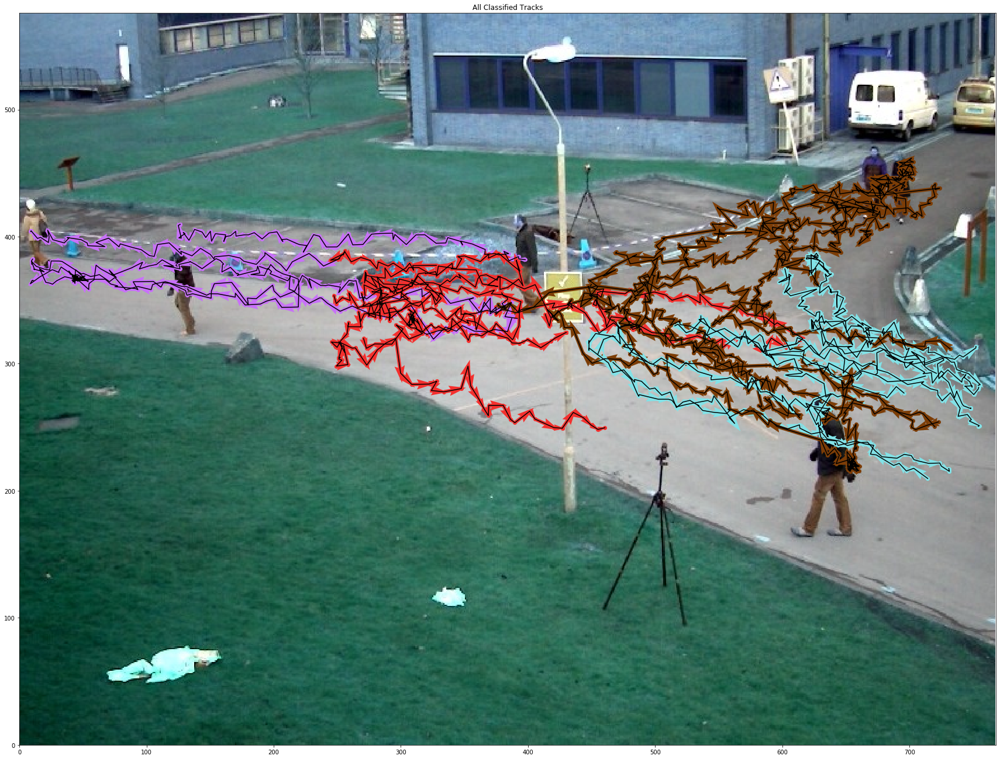

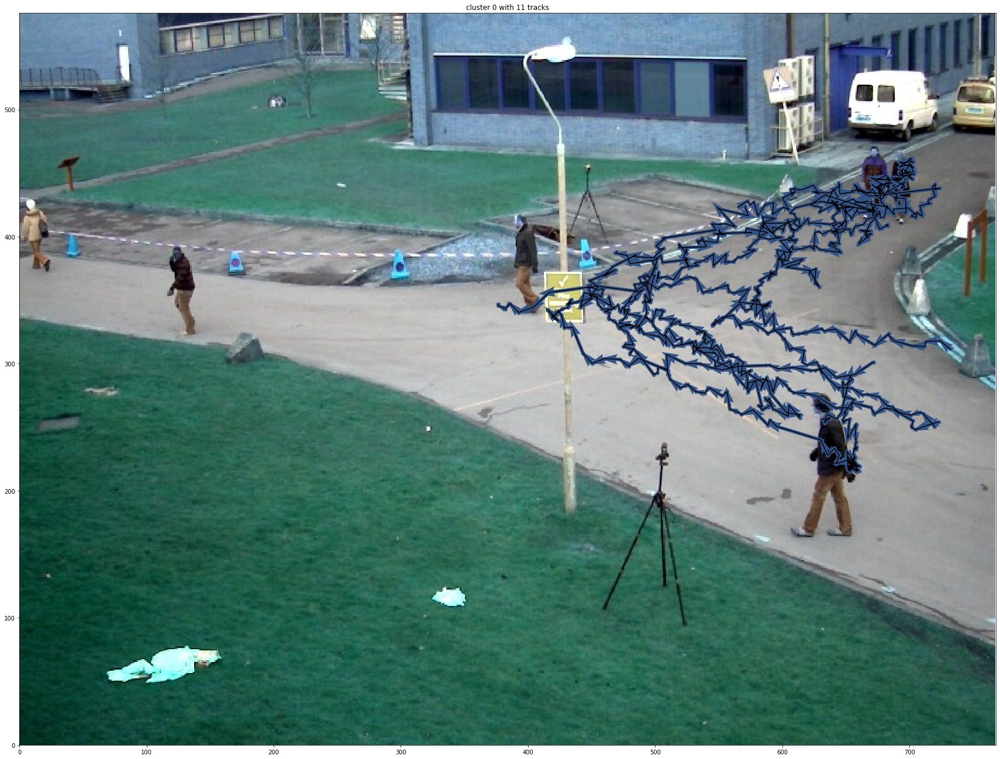

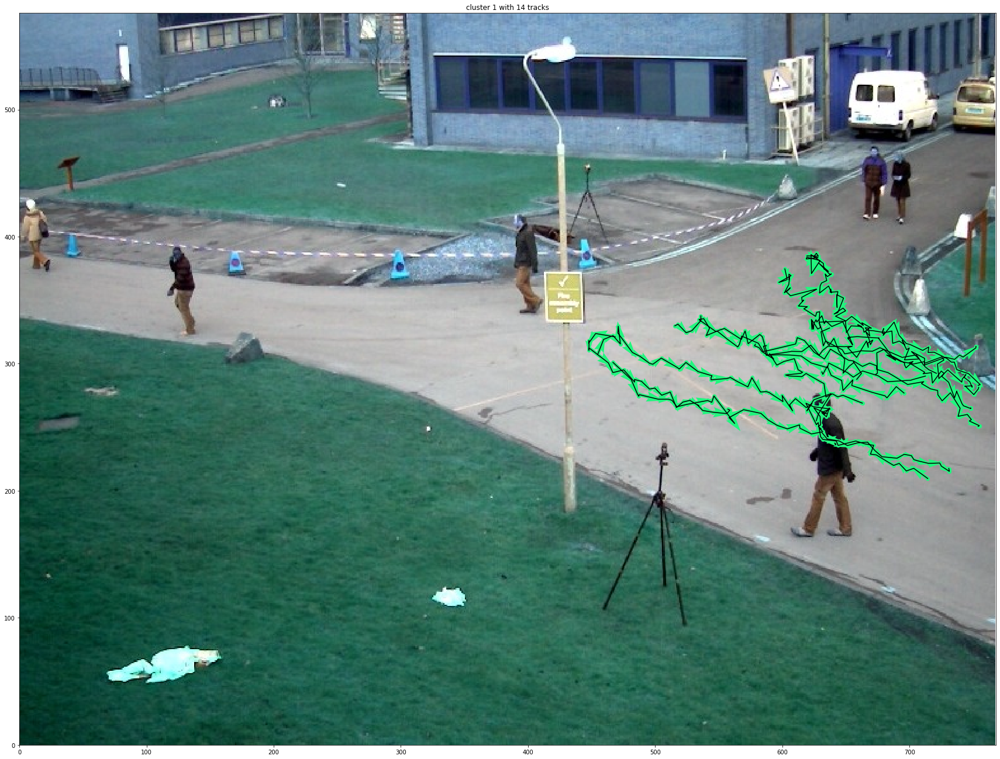

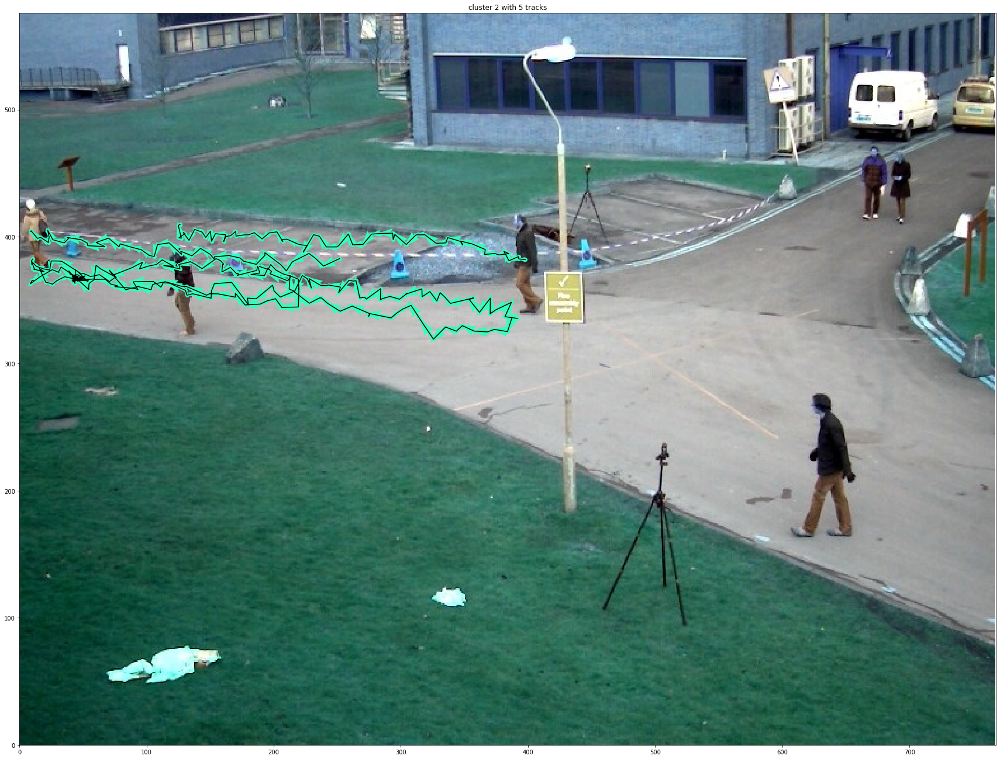

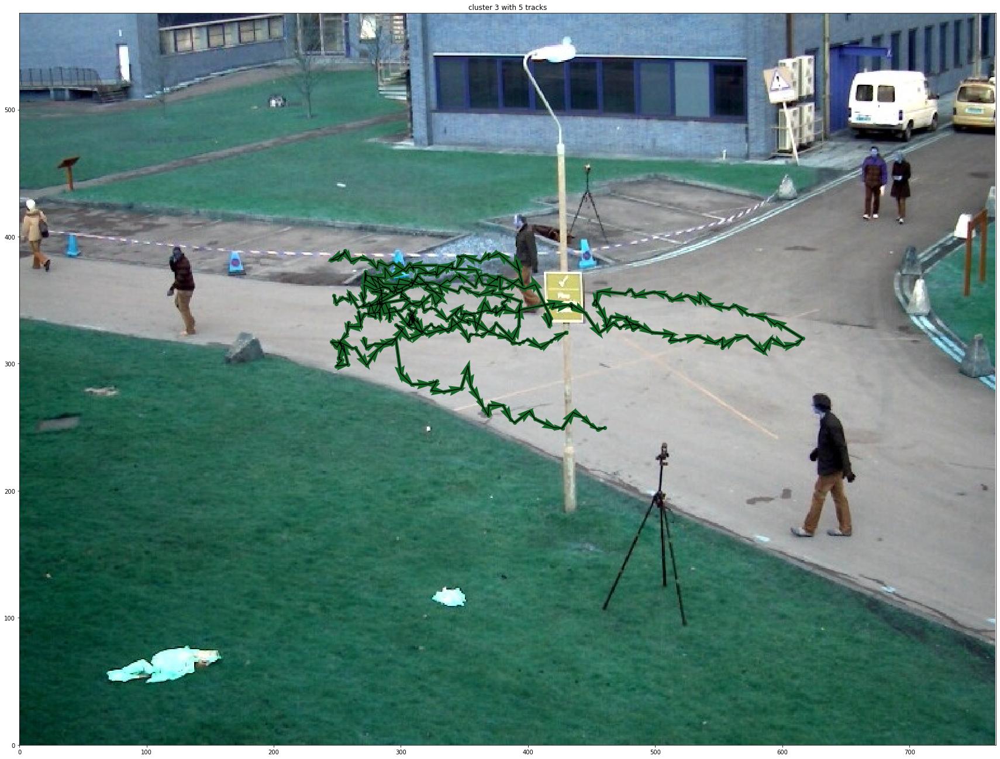

In [153]:
cluster = DBSCAN(eps=50, min_samples=4, metric="precomputed")
clusters_for_tracks = cluster.fit_predict(dist_matrix)
plot_tracks_with_quivers(clustered_tracks_dict, color_dict, "All Classified Tracks")
plot_every_cluster_alone_no_noise(tracks, clusters_for_tracks)